<a href="https://colab.research.google.com/github/AlvisSu/20220702-python-lesson/blob/main/20220716.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 20220709-作業參考

In [ ]:
!pip install gradio

In [2]:
import requests

In [3]:
def lookup(word):
  url="https://www.moedict.tw/a/"
  data=requests.get(url+word+".json").json()
  return data['English']

In [4]:
lookup("教室")

'classroom'

In [5]:
import gradio

In [8]:
gradio.Interface(lookup, "text", "text", title="漢英字典").launch(share=True)

Colab notebook detected. To show errors in colab notebook, set `debug=True` in `launch()`
Running on public URL: https://38760.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces (https://huggingface.co/spaces)


(<gradio.routes.App at 0x7f985c5c1fd0>,
 'http://127.0.0.1:7860/',
 'https://38760.gradio.app')

# 註冊ZeroJudge

* https://zerojudge.tw/Problems

解解看底下題目:

* https://zerojudge.tw/ShowProblem?problemid=a002
* https://zerojudge.tw/ShowProblem?problemid=a003

# 基本語法
* 迴圈 (loops) => for, while
* 函式 (functions)
* 條件式 (if statements)
* 例外處裡 (Exception Handling)

## 例外處裡

In [ ]:
#f字串
def add(x, y):
  print(f"{x}+{y}={x+y}")

In [19]:
add(2, 1)

2+1=3


In [24]:
def add(x, y):
  print(f"{x}+{y}={x+y}")

def sub(x, y):
  print(f"{x}-{y}={x-y}")

def mul(x, y):
  print(f"{x}x{y}={x*y}")

def div(x, y):
  print(f"{x}/{y}={x/y}")

In [25]:
functions=[add, div, mul, sub]

In [26]:
x=4
y=2
for func in functions:
  func(x, y)

4+2=6
4/2=2.0
4x2=8
4-2=2


In [27]:
#不美觀、可以蒐集程式碼片面資訊
x=4
y=0
for func in functions:
  func(x, y)

4+0=4


ZeroDivisionError: ignored

In [28]:
#例外處裡
x=4
y=0
for func in functions:
  try:
    func(x,y)
  except Exception as e:
    print(e.args)

4+0=4
('division by zero',)
4x0=0
4-0=4


# 資料分析簡介
* Numpy 
 * Numerical Python
 * 科學運算基礎套件
* MatPlotLib
 * Matrix Plotting Library
 * 繪圖基礎套件
* Pandas
 * Panel Data
 * 資料分析基礎套件

```python
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
```

## Numpy
* new data type
 * ndarray => Multi-Dimentional Array
* new functions to process data
 * ufunc => Universal Functions

## 使用原生的Python執行向量運算時會遇到的問題

In [30]:
x1=[1, 2, 3]
x2=[4, 5, 6]

In [11]:
x1+x2

[1, 2, 3, 4, 5, 6]

In [12]:
2*x1

[1, 2, 3, 1, 2, 3]

In [14]:
list(zip(x1, x2))

[(1, 4), (2, 5), (3, 6)]

In [13]:
#append是什麼
x3 = []
for i, j in zip(x1, x2):
  x3.append(i+j)

In [15]:
x3

[5, 7, 9]

## Numpy是用來做什麼?

### ndarray ==> 多維陣列

In [51]:
import numpy as np

In [52]:
x1

[1, 2, 3]

In [53]:
x2

[4, 5, 6]

In [68]:
y1=np.array(x1)
y2=np.array(x2)

In [56]:
y1+y2

array([5, 7, 9])

In [57]:
2*y1

array([2, 4, 6])

### ufunc ==> 通用函式

In [42]:
# 在原生的python中
import math

In [43]:
math.sin(math.pi/2)

1.0

In [44]:
math.sin(x1)

TypeError: ignored

In [45]:
#在numpy中，不管單一或好幾個值都可以算
math.sin(math.pi/2)

1.0

In [47]:
np.sin(x1)

array([0.84147098, 0.90929743, 0.14112001])

### 什麼地方什麼地方會用到Ndarray

In [58]:
import cv2

In [61]:
im=cv2.imread("su.JPG")

In [62]:
type(im)

numpy.ndarray

In [63]:
im.shape

(4912, 7360, 3)

In [66]:
import matplotlib.pyplot as plt

In [ ]:
plt.imshow(im)

# 如何用Python畫地圖

## LBS:Location-Based Service

Folium快速入門:

* https://python-visualization.github.io/folium/quickstart.html

In [69]:
import folium

m = folium.Map(location=[45.5236, -122.6750])

In [ ]:
m

In [ ]:
m = folium.Map(location=[22.6273, 120.3014], zoom_start=16)
m

In [75]:
#存成地圖
m.save("index.html")

In [ ]:
m = folium.Map(location=[22.6273, 120.3014], zoom_start=16)
folium.Marker([22.6273, 120.3014], popup="高雄市").add_to(m)
m

In [ ]:
m = folium.Map(location=[23.1113720, 120.2766632], zoom_start=16)
folium.Marker([23.1113720, 120.2766632], popup="台積電").add_to(m)
m

## 使用Geocoder查詢GPS座標

https://geocoder.readthedocs.io/

In [ ]:
!pip install geocoder

In [84]:
import geocoder

In [85]:
geocoder.osm("台北市").latlng

[25.0375198, 121.5636796]

### 練習：請使用Geocoder+folium畫出台北市地圖

In [ ]:
k=geocoder.osm("台北市").latlng
m=folium.Map(location=k, zoom_start=16)
folium.Marker(k, popup="台北市").add_to(m)
m

In [ ]:
place="國立中山大學大學"
gps=geocoder.osm(place).latlng
m=folium.Map(location=gps, zoom_start=16)
folium.Marker(gps, popup=place).add_to(m)
m

In [93]:
input(pla)
k=geocoder.osm("pla").latlng
m=folium.Map(location=k, zoom_start=16)
folium.Marker(k, popup="pla").add_to(m)
m

NameError: ignored

In [97]:
def draw_map(place):
  gps=geocoder.osm(place).latlng
  m=folium.Map(location=gps, zoom_start=16)
  folium.Marker(gps, popup=place).add_to(m)
  return m

In [ ]:
draw_map("宜蘭市")

### 練習:到政府資料開放平台，下載台北市YouBike站點資料，將之畫在地圖上

https://data.gov.tw/dataset/137993

https://tcgbusfs.blob.core.windows.net/dotapp/youbike/v2/youbike_immediate.json

In [100]:
import requests

In [101]:
url="https://tcgbusfs.blob.core.windows.net/dotapp/youbike/v2/youbike_immediate.json"

In [102]:
data=requests.get(url).json()

In [103]:
type(data)

list

In [104]:
data[0]

{'act': '1',
 'ar': '復興南路二段235號前',
 'aren': 'No.235， Sec. 2， Fuxing S. Rd.',
 'bemp': 25,
 'infoDate': '2022-07-16',
 'infoTime': '2022-07-16 11:51:37',
 'lat': 25.02605,
 'lng': 121.5436,
 'mday': '2022-07-16 11:51:37',
 'sarea': '大安區',
 'sareaen': 'Daan Dist.',
 'sbi': 3,
 'sna': 'YouBike2.0_捷運科技大樓站',
 'snaen': 'YouBike2.0_MRT Technology Bldg. Sta.',
 'sno': '500101001',
 'srcUpdateTime': '2022-07-16 11:55:12',
 'tot': 28,
 'updateTime': '2022-07-16 11:55:24'}

In [ ]:
### 練習01:請使用for迴圈print所有站點名稱及GPS座標。
### 練習02:請在地圖上標出所有站點位置及名稱。

In [109]:
data[0]["lat"]

25.02605

In [110]:
data[0]["lng"]

121.5436

In [111]:
data[0]["sna"]

'YouBike2.0_捷運科技大樓站'

In [121]:
x=data[0]["lat"]
y=data[0]["lng"]
n=data[0]["sna"]
print(n, x, y)

YouBike2.0_捷運科技大樓站 25.02605 121.5436


In [120]:
#要怎麼跑出data裡所有座標資料?
x=data[i]["lat"]
y=data[i]["lng"]
n=data[i]["sna"]
for i in range(10):
  print(n, x, y)

YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282
YouBike2.0_和平公園東側 25.02351 121.54282


In [ ]:
for x in data:
  print(f"{x['sna']}==>({x['lat']}, {x['lng']})")

In [ ]:
m=folium.Map(location=[x,y], zoom_start=16)
folium.Marker([x,y], popup=n).add_to(m)
m

In [138]:
def draw_map(place):
  gps=geocoder.osm(place).latlng
  m=folium.Map(location=gps, zoom_start=16)
  folium.Marker(gps, popup=place, icon=folium.Icon(color="red")).add_to(m)
  return m

In [ ]:
draw_map("台北市")

In [144]:
for x in data:
  #print(f"{x['sna']}==>({x['lat']}, {x['lng']})")
  folium.Marker([x['lat'],x['lng']], popup=x['sna']).add_to(m)

In [ ]:
m

# 用Python做影像處裡
 * pillow

## 需要載入的模組

In [147]:
from PIL import Image

## 讀取圖形檔

In [148]:
im=Image.open("su.JPG")

In [158]:
im

## 讀取圖片的資訊

In [152]:
im.size

(7360, 4912)

In [153]:
im.mode

'RGB'

In [157]:
im.format

'JPEG'

## 轉換成黑白圖片

Mode
https://pillow.readthedocs.io/en/stable/handbook/concepts.html

In [155]:
im_gray=im.convert("L")

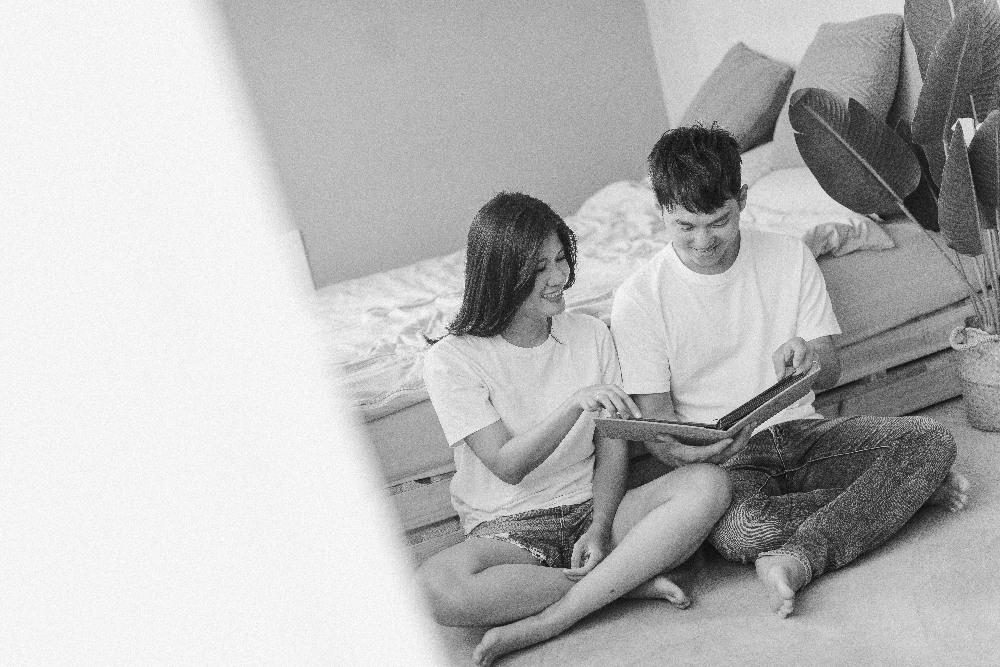

In [156]:
im_gray